In [27]:
# build complete binary miro-environment classifier using RFC
# explore the use the OSM feature and time-series feature
# evaluate on London validation & test set
# apply to unseen data of INHALE & DAPHNE dataset

In [28]:
import os
import warnings
import pandas as pd
import numpy as np
from os import path
from sklearn.neighbors import KNeighborsClassifier
from sklearn.cluster import KMeans
import data_process as dp
import draw_map as dm
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import f1_score, plot_confusion_matrix,accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
warnings. filterwarnings("ignore")

In [29]:
def min_max_norm(data, col):
    target_col = data[col]
    max_num = max(target_col.dropna())
    min_num = min(target_col.dropna())
    std = (target_col - min_num) / (max_num - min_num)
    data[col] = std
    
    return data

def smooth_label_indoor(data, window_size = 10, percentage = 1):
    i = 0    
    while i < (len(data)-window_size-1) :
        if sum(data.iloc[i:i+window_size+1]['pred_label'] == 0) > percentage: 
            data.iloc[i:i+window_size+1]['pred_label'] = 0
        i += window_size
    return data

def smooth_label_com(data, window_size = 10, percentage = 1):
    i = 0    
    while i < (len(data)-window_size-1) :
        if sum(data.iloc[i:i+window_size+1]['pred_label'] == 1) > percentage: 
            data.iloc[i:i+window_size+1]['pred_label'] = 1
        i += window_size
    return data

In [30]:
# load training data

In [31]:
data_dir = "./data/indoor_outdoor"
graph_dir = "./graphs"
data_path = os.path.join(data_dir, "new_data_set_with_roads_distance_land.csv")
data = pd.read_csv(data_path, index_col=0)
data = data[data['i/o'] != 1]
data.loc[data['i/o'].isin([2,1]), 'i/o'] = 1 # commuting 
data.sort_values(by=['timestamp'], inplace=True)

In [32]:
data.head()

,Unnamed: 0.1,timestamp,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,bin2,...,file label,i/o,gps_dist,gps_dist_std,geometry,highway,distance,close_road_idx,landuse,close_land_idx
4360,4360,1507895577439,2.205355,5.798239,8.180582,26.300001,59.0,0.616211,0.224609,0.073242,...,10,1,0.000000,0.0,POINT (-2.342155 53.36033000000001),unknown,0.005000,NaN,unknown,NaN
4361,4361,1507895597696,7.403782,19.711422,28.392464,26.300001,58.7,0.579108,0.200473,0.102096,...,10,1,0.002914,0.0,POINT (-2.3416583 53.3574583),unknown,0.005000,NaN,unknown,NaN
4362,4362,1507895761413,2.655042,8.001555,16.042948,26.300001,58.5,0.580913,0.212448,0.090456,...,10,1,0.014445,0.0,POINT (-2.3373167 53.34368170000001),tertiary,0.003235,30802.0,unknown,NaN
4363,4363,1507895782200,1.799130,4.281383,6.765331,26.400000,58.2,0.610268,0.243874,0.060677,...,10,1,0.004232,0.0,POINT (-2.33573 53.3397583),unclassified,0.000071,31537.0,unknown,NaN
4364,4364,1507895804320,1.281362,3.251580,6.702554,26.400000,58.0,0.626340,0.240429,0.070444,...,10,1,0.004402,0.0,POINT (-2.3341283 53.3356583),footway,0.000131,31558.0,unknown,NaN


In [5]:
origin_cols = data.columns
data.shape

(4552, 36)

In [6]:
data['close_road_idx'].fillna(0, inplace=True)
data['close_land_idx'].fillna(0, inplace=True)
# data['close_station_idx'].fillna(0, inplace=True)

In [33]:
# add time-series features
def add_time_feature_train(data, t=10):
    try:
        data.sort_values(by=['phoneTimestamp'], inplace=True)  
    except: 
        data.sort_values(by=['timestamp'], inplace=True) 
    time_data = data.iloc[0:2]
    time_data['avg_dist'] = 0
    time_data['same_land'] = 0
    time_data['same_road'] = 0
    for i in range(len(data) - t):
        if (len(data[i:i+t+1]['file label'].unique()) == 1):
            temp = data.iloc[i]
            if ((len(data[i:i+t+1]['close_road_idx'].unique()) == 1) and data.iloc[i]['close_road_idx'] != 0):
                temp['same_road'] = 1
            else:
                temp['same_road'] = 0
            if ((len(data[i:i+t+1]['close_land_idx'].unique()) == 1) and data.iloc[i]['close_land_idx'] != 0):
                temp['same_land'] = 1
            else:
                temp['same_land'] = 0  
            temp['avg_dist'] = data[i:i+t+1]['gps_dist'].mean()
            time_data = time_data.append(temp)
        
    time_data = time_data.iloc[2:]  
    time_data['highway'] = time_data['highway'].astype('category')
    time_data['highway_encode'] = time_data['highway'].cat.codes
    time_data['landuse'] = time_data['landuse'].astype('category')
    time_data['landuse_encode'] = time_data['landuse'].cat.codes

    
    return time_data

def add_time_feature(data, t=10):
    try:
        data.sort_values(by=['phoneTimestamp'], inplace=True)  
    except: 
        data.sort_values(by=['timestamp'], inplace=True) 
    time_data = data.iloc[0:2]
    time_data['avg_dist'] = 0
    time_data['same_land'] = 0
    time_data['same_road'] = 0
    for i in range(len(data) - t):
        temp = data.iloc[i]
        if ((len(data[i:i+t+1]['close_road_idx'].unique()) == 1) and data.iloc[i]['close_road_idx'] != 0):
            temp['same_road'] = 1
        else:
            temp['same_road'] = 0
        if ((len(data[i:i+t+1]['close_land_idx'].unique()) == 1) and data.iloc[i]['close_land_idx'] != 0):
            temp['same_land'] = 1
        else:
            temp['same_land'] = 0  
        temp['avg_dist'] = data[i:i+t+1]['gps_dist'].mean()
        time_data = time_data.append(temp)
        
    time_data = time_data.iloc[2:]  
    time_data['highway'] = time_data['highway'].astype('category')
    time_data['highway_encode'] = time_data['highway'].cat.codes
    time_data['landuse'] = time_data['landuse'].astype('category')
    time_data['landuse_encode'] = time_data['landuse'].cat.codes

    return time_data

In [8]:
time_data = add_time_feature_train(data, t=37)

In [9]:
#time_data = dp.min_max_norm(time_data, 'humidity')
#time_data = dp.min_max_norm(time_data, 'temperature')

In [10]:
chosen_columns = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
                  'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 
                  'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land'] 
chosen_columns1 = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
                   'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 
                   'highway_encode', 'distance', 'landuse_encode', 
                   'humidity', 'temperature', 'gps_dist'] 


X = time_data[chosen_columns] 
y = time_data['i/o']

In [11]:
np.unique(time_data['i/o'], return_counts=True) # indoor vs. commuting

(array([0, 1]), array([2067, 2080]))

In [292]:
## without train-test-split
#clf = RandomForestClassifier(random_state=0, n_estimators=130, min_samples_split=5, min_samples_leaf=5, max_depth=10)
#clf = RandomForestClassifier(random_state=0, max_depth=10)
#clf = RandomForestClassifier(random_state=0)
clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
clf.fit(X, y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_depth=10, random_state=0))])

In [300]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X, y)
importances = clf.feature_importances_
std = np.std([tree.feature_importances_ for tree in clf.estimators_],axis = 0)
indices = np.argsort(importances)[::-1]

features = []
importance = []

for f in range(X.shape[1]):
    features.append(X.columns[indices[f]])
    importance.append(importances[indices[f]])
out = pd.DataFrame()
out['Feature'] = features
out['Importance'] = importance
out

,Feature,Importance
0,avg_dist,0.210152
1,landuse_encode,0.179723
2,bin6,0.146474
3,highway_encode,0.113257
4,bin5,0.077121
5,bin7,0.074554
6,distance,0.047521
7,bin4,0.034104
8,bin8,0.025894
9,bin0,0.022990


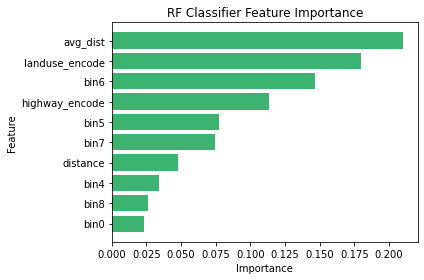

In [301]:
top5 = out[:10][::-1]
plt.barh(top5['Feature'], top5['Importance'], color = '#3CB371')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('RF Classifier Feature Importance')
plt.tight_layout()
# plt.savefig(path.join(graph_dir, 'rf_importance_2.pdf'))

## Some EDA

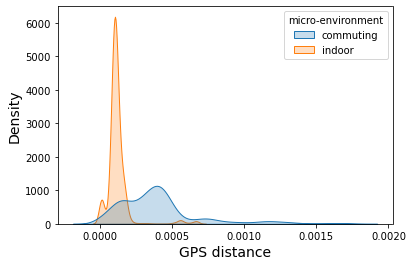

In [323]:
sns.kdeplot(data=time_data, x='avg_dist', hue='micro-environment', shade=True, palette="tab10")
plt.xlabel('GPS distance', fontsize=14)
plt.ylabel('Density', fontsize=14)

plt.savefig(path.join(graph_dir, 'train_dist_distribution.pdf'))

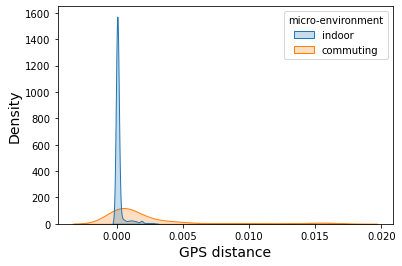

In [324]:
sns.kdeplot(data=test_time_data, x='avg_dist', hue='micro-environment', shade=True, palette="tab10")
plt.xlabel('GPS distance', fontsize=14)
plt.ylabel('Density', fontsize=14)
plt.savefig(path.join(graph_dir, 'test_dist_distribution.pdf'))

In [214]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=0)

In [215]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train, y_train)
y_preds = clf.predict(X_test)
print("Score: {}".format(clf.score(X_test, y_test)))
print("F1 Score: {}".format(f1_score(y_test, y_preds, average='weighted')))

Score: 0.9926953981008035
F1 Score: 0.9926966393763113


In [332]:
# load test data

In [12]:
test = pd.read_csv(path.join(data_dir, "london_unseen_data_with_roads_distance_land.csv"))
for i in range(800,1000):
    test.loc[i, 'label'] = 1  # manually re-label data
test.loc[test['label'] == 2 , 'label'] = 1 # commuting 

test['close_road_idx'].fillna(0, inplace=True)
test['close_land_idx'].fillna(0, inplace=True)
#test['close_station_idx'].fillna(0, inplace=True)

In [13]:
np.unique(test['label'], return_counts=True)

(array([0, 1]), array([669, 697]))

In [14]:
test_time_data = add_time_feature(test, t=37)
test_time_data_record = test_time_data

In [15]:
chosen_columns = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
                  'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15',
                  'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land'] 

X = time_data[chosen_columns] 
y = time_data['i/o']

#from sklearn.naive_bayes import GaussianNB
#clf = GaussianNB()
clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
#clf = RandomForestClassifier(random_state=0, max_depth=10)
clf.fit(X, y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_depth=10, random_state=0))])

In [16]:
## with time-series features
test_x = test_time_data[chosen_columns]
y = test_time_data['label']

y_test_preds = clf.predict(test_x)
test_time_data['pred_label'] = y_test_preds
    

print("Score: {}".format(accuracy_score(y, test_time_data['pred_label'])))
print("F1 Score: {}".format(f1_score(y, test_time_data['pred_label'], average='weighted')))

Score: 0.7975921745673439
F1 Score: 0.7976024902867628


In [34]:
def add_abs_diff(data, col):
    '''
    Calculate the Euclidean distance between two GPS points based on the longitude and latitude
    :param data: DataFrame --> Needs to include gpsLongitude and gpsLatitude features
    :return: DataFrame with gps_distance included as additional feature
    '''

    N = data.shape[0]
    diff = [0] * N
    data[col + '_diff'] = diff

    for n in range(1, N):
        data[col + '_diff'].iloc[n] = abs(data[col].iloc[n-1] - data[col].iloc[n])
    return data

In [230]:
time_data = add_abs_diff(time_data, 'temperature')
time_data = add_abs_diff(time_data, 'humidity')
test_time_data = add_abs_diff(test_time_data, 'temperature')
test_time_data = add_abs_diff(test_time_data, 'humidity')

In [35]:
# try with different feature sets

In [231]:
cols_no_bins = ['highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land', 'gps_dist']
cols_no_time = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'highway_encode', 'distance', 'landuse_encode', 'gps_dist']
cols_with_temp = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land', 'temperature']
cols_with_hum = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land', 'humidity']
cols_with_temp_hum = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land', 'humidity', 'temperature']
cols_with_tempdiff = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land', 'temperature_diff']
cols_with_humdiff = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gps_dist', 'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land', 'humidity_diff']

In [232]:
vary_scores = []
for c in [chosen_columns, cols_no_bins, cols_no_time, cols_with_temp, cols_with_hum, cols_with_temp_hum, cols_with_tempdiff, cols_with_humdiff]:
    X = time_data[c] 
    y = time_data['i/o']
    clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
    clf.fit(X, y)
    
    test_x = test_time_data[c]
    y = test_time_data['label']

    y_test_preds = clf.predict(test_x)
    test_time_data['pred_label'] = y_test_preds
    
    score = accuracy_score(y, test_time_data['pred_label'])
    vary_scores.append(score)

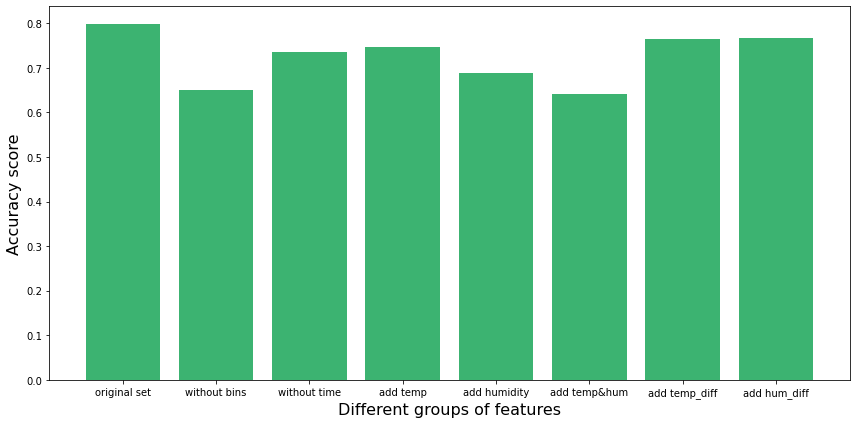

In [235]:
fig, ax = plt.subplots(figsize=(12,6))
plt.xlabel('Different groups of features', fontsize=16)
plt.ylabel('Accuracy score', fontsize=16)
label = ['original set', 'without bins', 'without time', 'add temp', 'add humidity', 'add temp&hum', 'add temp_diff', 'add hum_diff']
ax.bar(label, vary_scores, color = '#3CB371')

plt.tight_layout()

In [18]:
# the complete classification on validation set
# Accuracy score: 0.870

X = time_data[chosen_columns] 
y = time_data['i/o']
#clf = RandomForestClassifier(random_state=0)
clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
clf.fit(X, y)

test_x = test_time_data[chosen_columns]
y = test_time_data['label']
y_test_preds = clf.predict(test_x)
test_time_data['pred_label'] = y_test_preds


test_time_data = smooth_label_indoor(test_time_data, window_size=5, percentage=2)
test_time_data = smooth_label_com(test_time_data, window_size=10, percentage=8)
test_time_data.loc[test_time_data['landuse'] == 'outland', 'pred_label'] = 1
test_time_data.loc[test_time_data['highway'].isin(['tertiary', 'unclassified', 'primary_secondary']), 'pred_label'] = 1

print("Score: {}".format(accuracy_score(y, test_time_data['pred_label'])))
print("F1 Score: {}".format(f1_score(y, test_time_data['pred_label'], average='weighted')))

Score: 0.8698269375470279
F1 Score: 0.8697437761237414


In [36]:
# some EDA

In [362]:
act, num = np.unique(test_time_data['activity'], return_counts=True) # indoor vs. commuting

In [365]:
indoor = []
act, num = list(act), list(num)
for a in act:
    indoor.append(len(test_time_data[test_time_data['activity'] == a][test_time_data['pred_label'] == 0]))

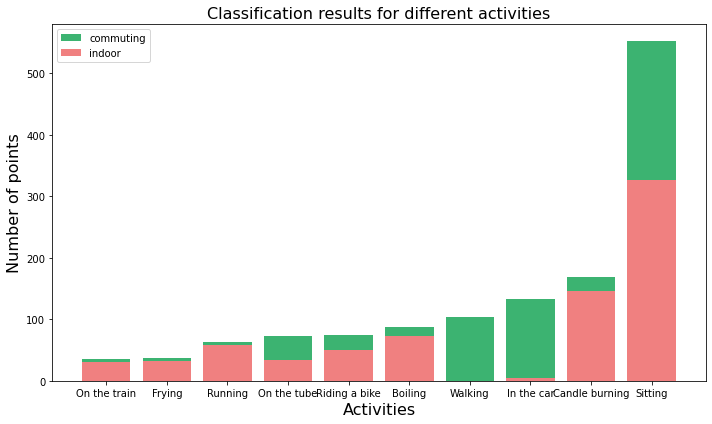

In [367]:
df = pd.DataFrame({'indoor': indoor, 'commuting':num}, 
             index=act)

df = df.sort_values(by='commuting')

fig, ax = plt.subplots(figsize=(10,6))
plt.title('Classification results for different activities', fontsize=16)
plt.xlabel('Activities', fontsize=16)
plt.ylabel('Number of points', fontsize=16)
ax.bar(df.index, df['commuting'], color = '#3CB371', label='commuting')

ax.bar(df.index, df['indoor'], color = 'lightcoral', label='indoor')

ax.legend()
plt.tight_layout()
plt.savefig(path.join(graph_dir, 'test_pred_activities_d.pdf'))

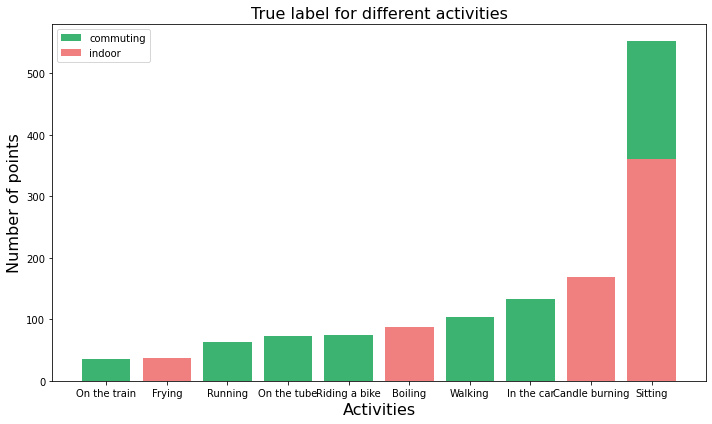

In [358]:
df = pd.DataFrame({'indoor': indoor, 'commuting':num}, 
             index=act)

df = df.sort_values(by='commuting')

fig, ax = plt.subplots(figsize=(10,6))
plt.title('True label for different activities', fontsize=16)
plt.xlabel('Activities', fontsize=16)
plt.ylabel('Number of points', fontsize=16)
ax.bar(df.index, df['commuting'], color = '#3CB371', label='commuting')

ax.bar(df.index, df['indoor'], color = 'lightcoral', label='indoor')

ax.legend()
plt.tight_layout()
plt.savefig(path.join(graph_dir, 'test_true_activities_d.pdf'))

In [368]:
land, num = np.unique(time_data['landuse'], return_counts=True) # indoor vs. commuting

In [375]:
indoor = []
land, num = list(land), list(num)
for l in land:
    indoor.append(len(test_time_data[test_time_data['landuse'] == l][test_time_data['label'] == 0]))

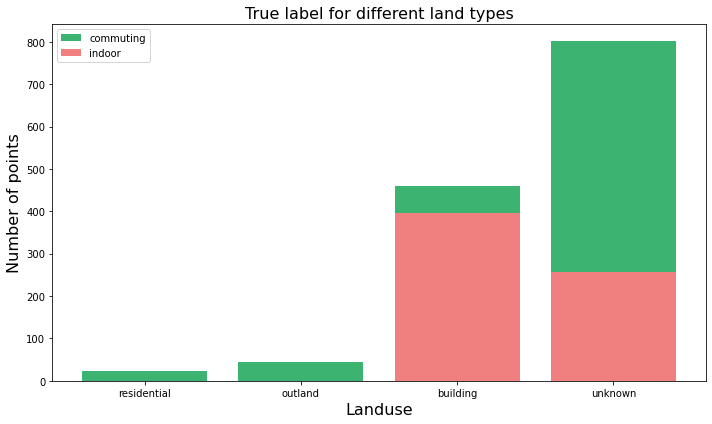

In [376]:
df = pd.DataFrame({'indoor': indoor, 'commuting':num}, 
             index=land)

df = df.sort_values(by='commuting')

fig, ax = plt.subplots(figsize=(10,6))
plt.title('True label for different land types', fontsize=16)
plt.xlabel('Landuse', fontsize=16)
plt.ylabel('Number of points', fontsize=16)
ax.bar(df.index, df['commuting'], color = '#3CB371', label='commuting')

ax.bar(df.index, df['indoor'], color = 'lightcoral', label='indoor')

ax.legend()
plt.tight_layout()
plt.savefig(path.join(graph_dir, 'test_true_land_d.pdf'))

In [371]:
land, num = np.unique(test_time_data['landuse'], return_counts=True) # indoor vs. commuting

In [372]:
indoor = []
land, num = list(land), list(num)
for l in land:
    indoor.append(len(test_time_data[test_time_data['landuse'] == l][test_time_data['pred_label'] == 0]))

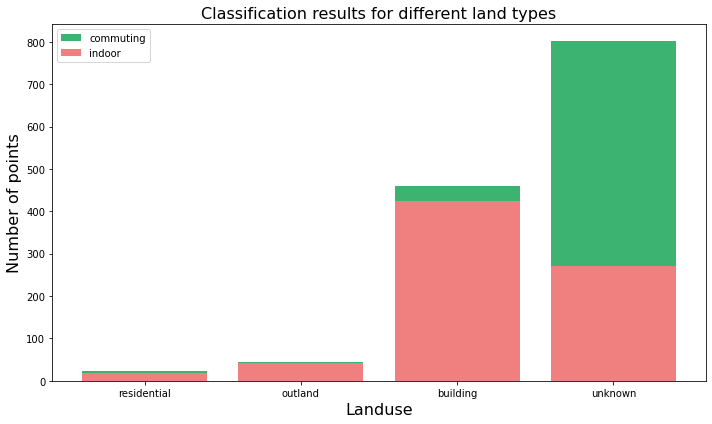

In [374]:
df = pd.DataFrame({'indoor': indoor, 'commuting':num}, 
             index=land)

df = df.sort_values(by='commuting')

fig, ax = plt.subplots(figsize=(10,6))
plt.title('Classification results for different land types', fontsize=16)
plt.xlabel('Landuse', fontsize=16)
plt.ylabel('Number of points', fontsize=16)
ax.bar(df.index, df['commuting'], color = '#3CB371', label='commuting')

ax.bar(df.index, df['indoor'], color = 'lightcoral', label='indoor')

ax.legend()
plt.tight_layout()
plt.savefig(path.join(graph_dir, 'test_pred_land_d.pdf'))

In [377]:
road, num = np.unique(test_time_data['highway'], return_counts=True) # indoor vs. commuting

In [378]:
indoor = []
road, num = list(road), list(num)
for r in road:
    indoor.append(len(test_time_data[test_time_data['highway'] == r][test_time_data['label'] == 0]))

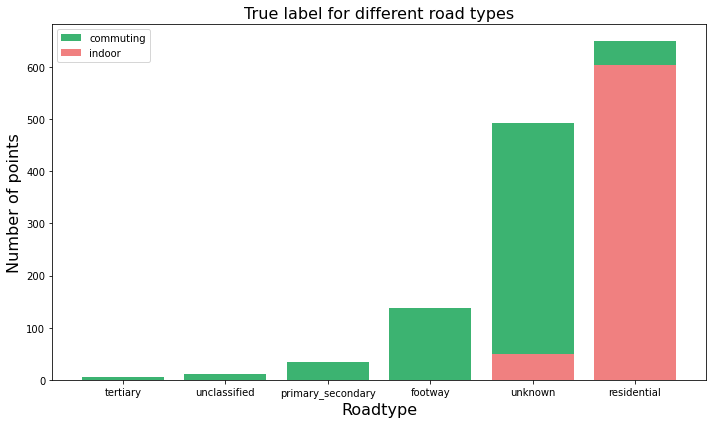

In [379]:
df = pd.DataFrame({'indoor': indoor, 'commuting':num}, 
             index=road)

df = df.sort_values(by='commuting')

fig, ax = plt.subplots(figsize=(10,6))
plt.title('True label for different road types', fontsize=16)
plt.xlabel('Roadtype', fontsize=16)
plt.ylabel('Number of points', fontsize=16)
ax.bar(df.index, df['commuting'], color = '#3CB371', label='commuting')

ax.bar(df.index, df['indoor'], color = 'lightcoral', label='indoor')

ax.legend()
plt.tight_layout()
plt.savefig(path.join(graph_dir, 'test_true_road_d.pdf'))

In [380]:
road, num = np.unique(test_time_data['highway'], return_counts=True) # indoor vs. commuting

In [383]:
indoor = []
road, num = list(road), list(num)
for r in road:
    indoor.append(len(test_time_data[test_time_data['highway'] == r][test_time_data['pred_label'] == 0]))

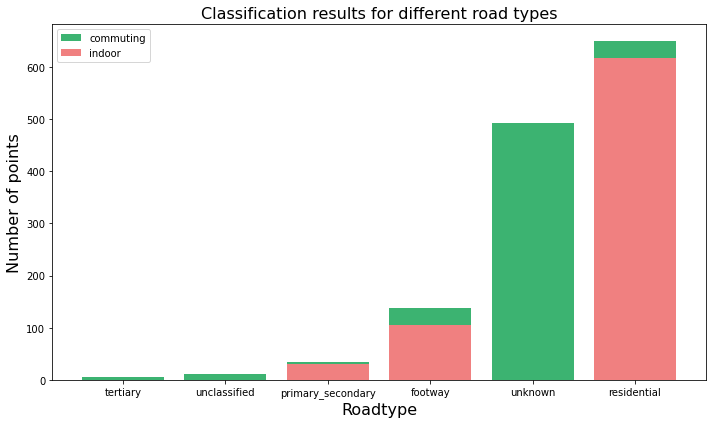

In [384]:
df = pd.DataFrame({'indoor': indoor, 'commuting':num}, 
             index=road)

df = df.sort_values(by='commuting')

fig, ax = plt.subplots(figsize=(10,6))
plt.title('Classification results for different road types', fontsize=16)
plt.xlabel('Roadtype', fontsize=16)
plt.ylabel('Number of points', fontsize=16)
ax.bar(df.index, df['commuting'], color = '#3CB371', label='commuting')

ax.bar(df.index, df['indoor'], color = 'lightcoral', label='indoor')

ax.legend()
plt.tight_layout()
plt.savefig(path.join(graph_dir, 'test_pred_road_d.pdf'))

In [273]:
run = test_time_data[test_time_data['activity'] == 'Running']
c = dm.getCoords(run)
dm.getMap(c, run, 'pred_label', classification=False)

In [274]:
run['avg_dist'].mean()

0.7033331504686077

In [276]:
walk = test_time_data[test_time_data['activity'] == 'Walking']
c = dm.getCoords(walk)
dm.getMap(c, walk, 'pred_label', classification=False)

In [277]:
walk['avg_dist'].mean()

0.17698474006582796

In [386]:
train = test_time_data[test_time_data['activity'] == 'On the tube']
c = dm.getCoords(train)
dm.getMap(c, train, 'pred_label', classification=False)

In [37]:
# select a suitable window size 

In [69]:
scores = []
for tt in range(1,51):
    time_data = add_time_feature_train(data, t=tt)
    X = time_data[chosen_columns] 
    y = time_data['i/o']
    clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
    clf.fit(X, y)
    
    test_time_data = add_time_feature(test, t=tt)
    test_x = test_time_data[chosen_columns]
    y = test_time_data['label']

    y_test_preds = clf.predict(test_x)
    test_time_data['pred_label'] = y_test_preds
    
    scores.append(accuracy_score(y, test_time_data['pred_label']))


In [333]:
scores = [
 0.8967032967032967,
 0.9046920821114369,
 0.9046221570066031,
 0.9074889867841409,
 0.9088905216752388,
 0.9088235294117647,
 0.9094922737306843,
 0.9086892488954345,
 0.9027266028002948,
 0.9041297935103245,
 0.9040590405904059,
 0.9039881831610044,
 0.9031781226903178,
 0.9038461538461539,
 0.9045151739452257,
 0.9051851851851852,
 0.9058561897702001,
 0.905786350148368,
 0.9049740163325909,
 0.9049034175334324,
 0.9048327137546468,
 0.9040178571428571,
 0.9039463886820551,
 0.9031296572280179,
 0.9038031319910514,
 0.9037313432835821,
 0.9044062733383121,
 0.9035874439461884,
 0.9035153328347045,
 0.9019461077844312,
 0.9011235955056179,
 0.8995502248875562,
 0.8964741185296324,
 0.8933933933933934,
 0.8933132982719759,
 0.8917293233082707,
 0.8886380737396539,
 0.8870481927710844,
 0.8839487565938207,
 0.8808446455505279,
 0.8784905660377359,
 0.8753776435045317,
 0.872260015117158,
 0.869894099848714,
 0.8675246025738077,
 0.8643939393939394,
 0.8612585291887794,
 0.8603945371775418,
 0.8572513287775246,
 0.8533434650455927]

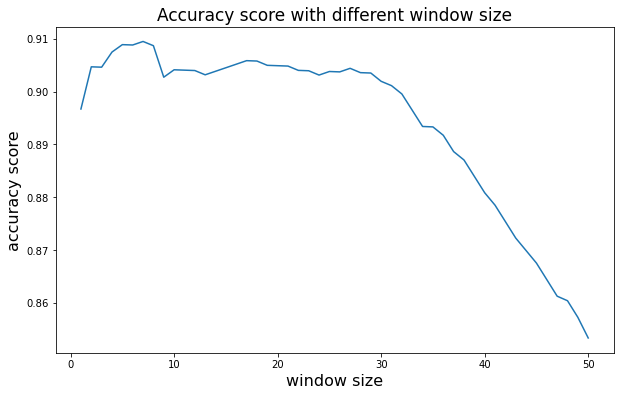

In [18]:
plt.subplots(figsize = (10,6))
x = np.array(range(1,51))
plt.plot(x,scores)
plt.xlabel("window size", fontsize = 16)
plt.ylabel('accuracy score', fontsize = 16)
plt.title('Accuracy score with different window size', fontsize = 17)
plt.savefig(path.join(graph_dir, 'window_size.pdf'))

In [ ]:
scores = []
for tt in range(1,51):
    time_data = add_time_feature_train(data, t=tt)
    X = time_data[chosen_columns] 
    y = time_data['i/o']
    clf = RandomForestClassifier(random_state=0)
    clf.fit(X, y)
    
    test_time_data = add_time_feature(test, t=tt)
    test_x = test_time_data[chosen_columns]
    y = test_time_data['label']

    y_test_preds = clf.predict(test_x)
    test_time_data['pred_label'] = y_test_preds
    
    scores.append(accuracy_score(y, test_time_data['pred_label']))

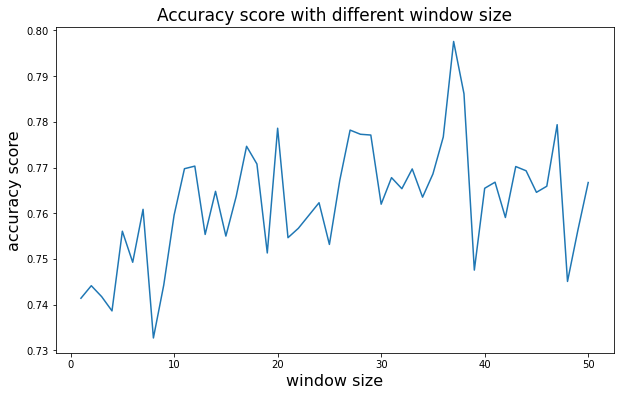

In [156]:
plt.subplots(figsize = (10,6))
x = np.array(range(1,51))
plt.plot(x,scores)
plt.xlabel("window size", fontsize = 16)
plt.ylabel('accuracy score', fontsize = 16)
plt.title('Accuracy score with different window size', fontsize = 17)
plt.savefig(path.join(graph_dir, 'window_size_new.pdf'))

In [25]:
def plot_confusion_m(y_true, y_pred,  normalize=None,
                          title='Confusion Matrix', plot_numbers=False, display_names=None,
                          figsize=(10, 9)):

    cm = confusion_matrix(y_true, y_pred,  normalize=normalize)
    

    df_cm = pd.DataFrame(cm, index=display_names, columns=display_names).round(2)
    fig = plt.figure(figsize=figsize)
    sns.heatmap(df_cm, annot=plot_numbers, cmap='Blues', fmt='g')
    plt.setp(plt.gca().get_xticklabels(), ha="right", rotation=45)
    plt.ylabel('True Label', fontsize = 16)
    plt.xlabel('Predicted Label', fontsize = 16)
    plt.title(title, fontsize = 18)
    plt.savefig(path.join(graph_dir, 'confusion_t.pdf'))
    #return fig

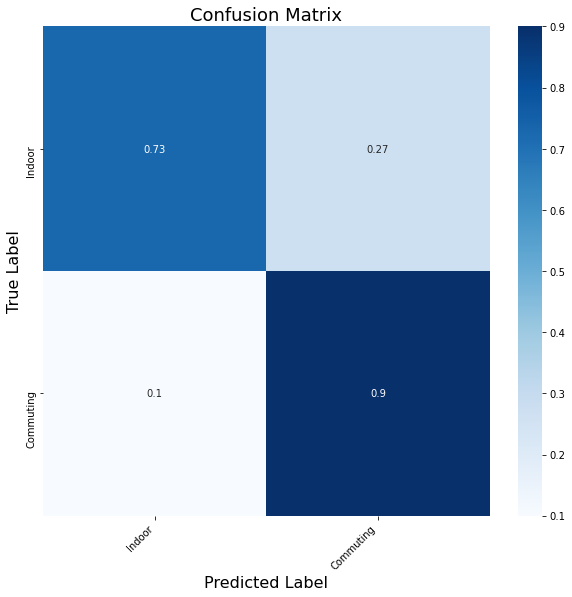

In [26]:
# plot_confusion_m(y,test_time_data['pred_label'],  display_names=['Indoor', 'Commuting'], normalize='true', plot_numbers=True)
plot_confusion_m(y,new_test_data['pred_label'],  display_names=['Indoor', 'Commuting'], normalize='true', plot_numbers=True)


In [419]:
c = dm.getCoords(test_time_data)
dm.getMap(c, test_time_data, 'pred_label', classification=True)

## Apply on London selected data

In [19]:
test_london = pd.read_csv(path.join(data_dir, "all_data_new_select_with_roads_distance_land_processed.csv"))

In [20]:
test_london.head()

,Unnamed: 0,pm1,pm2_5,pm10,temperature,humidity,bin0,bin1,bin2,bin3,...,distance,landuse,gps_dist,gps_dist_std,i/o,geometry,close_road_idx,close_land_idx,activity,activity_type
0,0,31.357779,68.628010,168.52596,25.9,38.300000,0.818769,0.126585,0.028591,0.010376,...,0.000137,building,0.000000,0.0,0,POINT (-0.1322896 51.565227),13999.0,14550.0,Sitting,0
1,1,31.063381,68.659660,199.63565,25.9,39.000000,0.841306,0.103577,0.027454,0.011335,...,0.000056,unknown,0.000196,0.0,0,POINT (-0.1321484 51.5650911),13999.0,0.0,Sitting,0
2,2,31.755910,68.593600,211.94217,26.7,37.200000,0.812405,0.132666,0.027581,0.011521,...,0.000058,unknown,0.000056,0.0,0,POINT (-0.1321928 51.5650568),13999.0,0.0,Sitting,0
3,3,31.561163,71.432800,229.19894,27.6,36.100002,0.826067,0.117191,0.027303,0.011236,...,0.000058,unknown,0.000000,0.0,0,POINT (-0.1321928 51.5650568),13999.0,0.0,Sitting,0
4,4,32.124138,66.662285,185.78313,28.2,34.900000,0.836942,0.111326,0.027233,0.011623,...,0.000058,unknown,0.000000,0.0,0,POINT (-0.1321928 51.5650568),13999.0,0.0,Sitting,0


In [21]:
new_test = add_time_feature(test_london, t=37)

In [24]:
X = time_data[chosen_columns] 
y = time_data['i/o']
#clf = RandomForestClassifier(random_state=0)
clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
clf.fit(X, y)


test_x = new_test[chosen_columns]
y = new_test['i/o']

y_test_preds = clf.predict(test_x)
new_test['pred_label'] = y_test_preds

new_test_data = smooth_label_indoor(new_test, window_size=10, percentage=4)
new_test_data = smooth_label_com(new_test_data, window_size=10, percentage=9)

new_test_data.loc[new_test_data['landuse'] == 'outland', 'pred_label'] = 1
new_test_data.loc[new_test_data['highway'].isin(['tertiary', 'unclassified', 'primary_secondary']), 'pred_label'] = 1

print("Score: {}".format(accuracy_score(y, new_test_data['pred_label'])))
print("F1 Score: {}".format(f1_score(y, new_test_data['pred_label'], average='weighted')))

Score: 0.7915728530073979
F1 Score: 0.7954364561183785


In [23]:
test_london.shape

(6255, 38)

In [320]:
c = dm.getCoords(test_london)
dm.getMap(c, test_london, 'i/o', classification=True)

In [321]:
c = dm.getCoords(new_test)
dm.getMap(c, new_test, 'pred_label', classification=True)

## Mode of transport classification

In [334]:
new_test = new_test[new_test['i/o'] == 1]

In [335]:
X = new_test[chosen_columns]
y = new_test['activity'].astype('category').cat.codes

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=0)

clf = RandomForestClassifier(random_state=0)
clf.fit(X_train, y_train)
y_preds = clf.predict(X_test)
print("Score: {}".format(clf.score(X_test, y_test)))
print("F1 Score: {}".format(f1_score(y_test, y_preds, average='weighted')))

Score: 0.832
F1 Score: 0.8324887567741026


In [336]:
categories = ['In the car', 'On the bus', 'Riding a bike', 'Running', 'Walking']

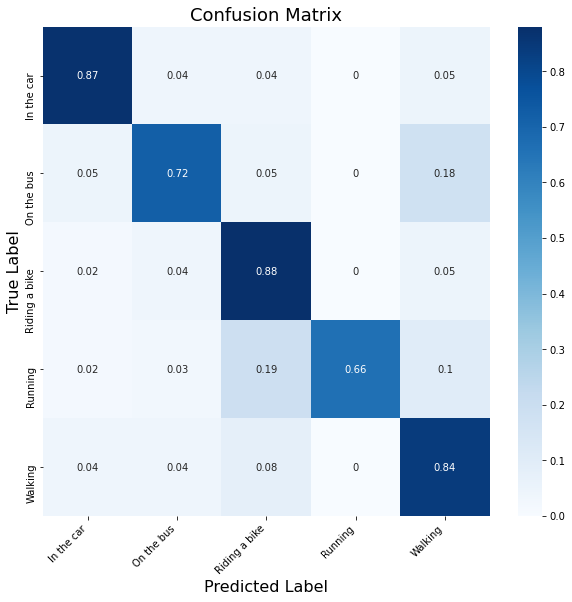

In [338]:
plot_confusion_m(y_test , y_preds,  display_names=categories, normalize='true', plot_numbers=True)

In [339]:
importances = clf.feature_importances_
std = np.std([tree.feature_importances_ for tree in clf.estimators_],axis = 0)
indices = np.argsort(importances)[::-1]

features = []
importance = []

for f in range(X.shape[1]):
    features.append(X.columns[indices[f]])
    importance.append(importances[indices[f]])
out = pd.DataFrame()
out['Feature'] = features
out['Importance'] = importance
out[:10]

,Feature,Importance
0,avg_dist,0.169599
1,distance,0.150306
2,highway_encode,0.085925
3,bin2,0.063981
4,bin1,0.056200
5,bin0,0.055312
6,bin3,0.053362
7,bin5,0.047186
8,bin6,0.046565
9,bin4,0.044722


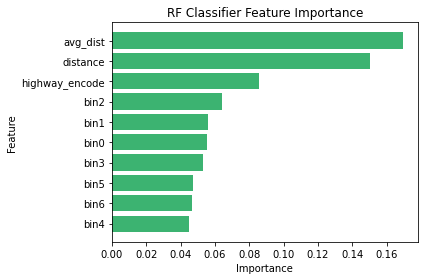

In [340]:
top5 = out[:10][::-1]
plt.barh(top5['Feature'], top5['Importance'], color = '#3CB371')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('RF Classifier Feature Importance')
plt.tight_layout()
#plt.savefig(path.join(graph_dir, 'rf_importance_commuting.pdf'))

## Merge London & Edinburgh labelled data

In [322]:
merge_cols = ['pm1', 'pm2_5', 'pm10', 'temperature', 'humidity', 'bin0', 'bin1', 'bin2',
       'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8', 'bin9', 'bin10',
       'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'gpsLongitude',
       'gpsLatitude', 'gpsAccuracy', 'file label', 'timestamp', 'highway', 'distance', 'landuse', 'gps_dist',
       'gps_dist_std', 'i/o', 'geometry', 'close_road_idx', 'close_land_idx']

In [323]:
london = test_london[merge_cols]
edin = data[merge_cols]

In [324]:
edin_london_data = pd.concat([london, edin])
np.unique(edin_london_data['i/o'], return_counts=True)

(array([0, 1]), array([6126, 4681]))

In [325]:
edin_london_data.to_csv(os.path.join(data_dir,'edin_london_data.csv'))

In [326]:
all_train_time =  add_time_feature_train(edin_london_data, t=37)

In [327]:
chosen_columns = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
                  'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 
                  'highway_encode', 'distance', 'landuse_encode', 
                  'avg_dist', 'same_road', 'same_land']


X = all_train_time[chosen_columns] 
y = all_train_time['i/o']

In [328]:
clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
clf.fit(X, y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestclassifier',
                 RandomForestClassifier(max_depth=10, random_state=0))])

In [133]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X, y)
importances = clf.feature_importances_
std = np.std([tree.feature_importances_ for tree in clf.estimators_],axis = 0)
indices = np.argsort(importances)[::-1]

features = []
importance = []

for f in range(X.shape[1]):
    features.append(X.columns[indices[f]])
    importance.append(importances[indices[f]])
out = pd.DataFrame()
out['Feature'] = features
out['Importance'] = importance
out[:10]

,Feature,Importance
0,avg_dist,0.404058
1,landuse_encode,0.131420
2,bin6,0.076514
3,bin5,0.064679
4,distance,0.047379
5,highway_encode,0.044204
6,bin7,0.043001
7,same_road,0.034535
8,bin8,0.026741
9,bin0,0.023496


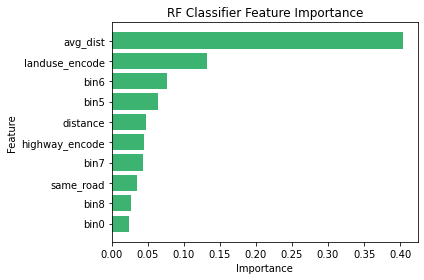

In [135]:
top5 = out[:10][::-1]
plt.barh(top5['Feature'], top5['Importance'], color = '#3CB371')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('RF Classifier Feature Importance')
plt.tight_layout()
# plt.savefig(path.join(graph_dir, 'rf_importance_3.pdf'))

## Apply on INHALE / DAPHNE data

In [380]:
def manual_adjust(data):
    data.loc[data['landuse'] == 'outland', 'pred_label'] = 1
    data.loc[data['highway'].isin(['tertiary', 'unclassified', 'primary_secondary']), 'pred_label'] = 1
    
    return data

In [655]:
#out_dir = "./data/inhale/processed"
#out_path = path.join(out_dir, "LIX006.csv")
#inhale = pd.read_csv(out_path, index_col=0)

out_dir = "./data/daphne/processed_data"
out_path = path.join(out_dir, "DAP114.csv")
inhale = pd.read_csv(out_path, index_col=0)

In [656]:
np.unique(inhale['landuse'], return_counts=True)

(array(['unknown'], dtype=object), array([2457]))

In [657]:
np.unique(inhale['highway'], return_counts=True)

(array(['footway', 'primary_secondary', 'residential', 'tertiary',
        'unclassified', 'unknown'], dtype=object),
 array([   1,  210, 2140,    1,   83,   22]))

In [658]:
test_inhale = add_time_feature(inhale, t=37)

In [659]:
chosen_columns = ['bin0', 'bin1', 'bin2', 'bin3', 'bin4', 'bin5', 'bin6', 'bin7', 'bin8',
       'bin9', 'bin10', 'bin11', 'bin12', 'bin13', 'bin14', 'bin15', 'highway_encode', 'distance',  
                  'avg_dist', 'same_road']

X = all_train_time[chosen_columns] 
y = all_train_time['i/o']
clf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state=0, max_depth=10))
clf.fit(X, y)

test_x = test_inhale[chosen_columns]

y_test_preds = clf.predict(test_x)
test_inhale['pred_label'] = y_test_preds

In [660]:
np.unique(test_inhale['pred_label'], return_counts=True)

(array([0, 1]), array([2060,  360]))

In [662]:
test_inhale = smooth_label_indoor(test_inhale, window_size=10, percentage=5)
test_inhale = smooth_label_com(test_inhale, window_size=10, percentage=10)

In [663]:
np.unique(test_inhale['pred_label'], return_counts=True)

(array([0, 1]), array([2090,  330]))

In [563]:
test_inhale = manual_adjust(test_inhale)

In [564]:
np.unique(test_inhale['pred_label'], return_counts=True)

(array([0, 1]), array([ 670, 2191]))

In [664]:
c = dm.getCoords(test_inhale)
dm.getMap(c, test_inhale, 'pred_label', classification=True)